## **Tutorial:** https://youtu.be/bFeltWvzZpQ?si=o2BGXkm9YtHEK-rG

In [ ]:
from google.colab import drive
drive.mount('/content/drive') #/content/drive/MyDrive/TIES4911_Demos/Demo 5/Test Images

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
def load_image(img_path):
    img = tf.io.read_file(img_path)
    img = tf.image.decode_image(img, channels=3)
    img = tf.image.convert_image_dtype(img, tf.float32)
    img = img[tf.newaxis, :]
    return img

In [6]:
content_images = "/content/drive/MyDrive/TIES4911_Demos/Demo 5/Test Images/"
style_images = "/content/drive/MyDrive/TIES4911_Demos/Demo 5/Style Images/"

In [15]:
content = os.listdir(content_images)
style = os.listdir(style_images)

### **Content Images**

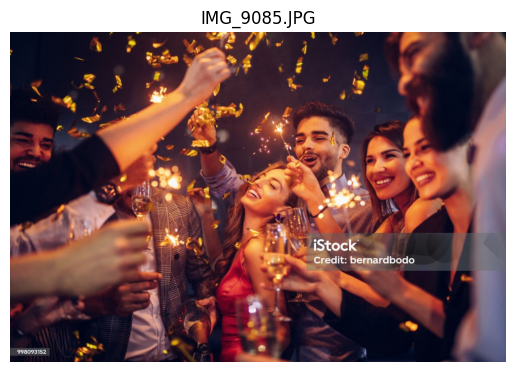

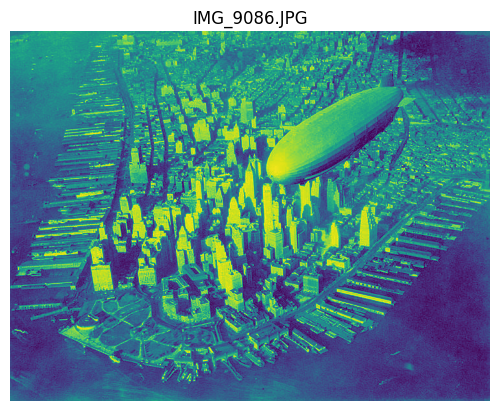

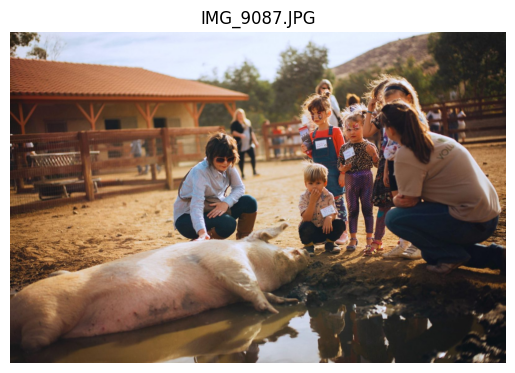

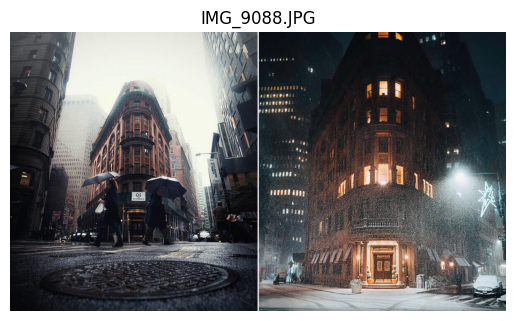

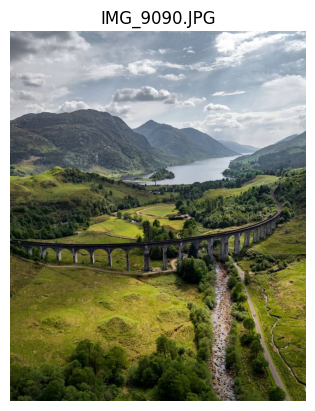

...

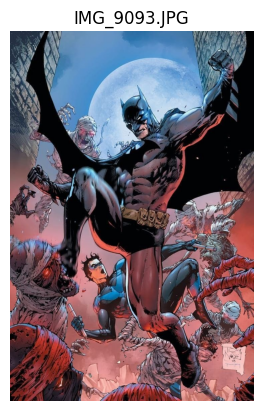

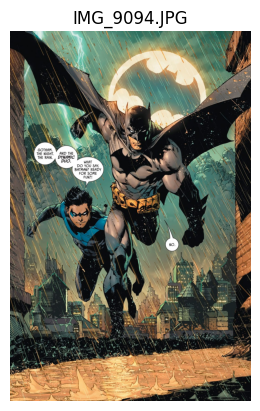

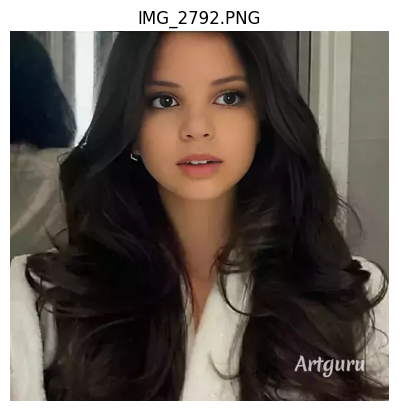

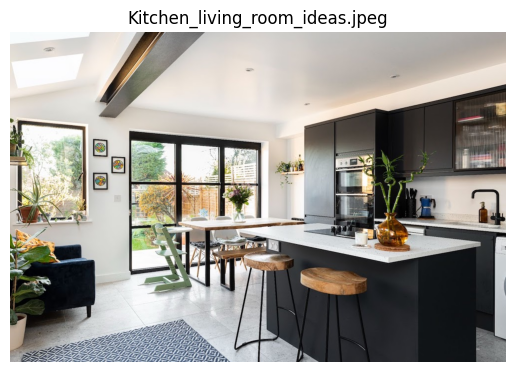

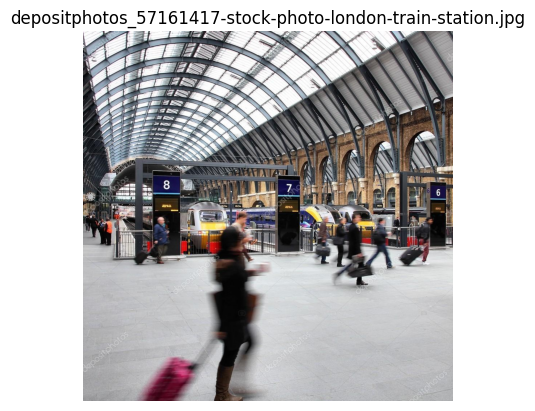

In [16]:
import matplotlib.pyplot as plt
from PIL import Image

# Visualize each image
for file_name in content:
    # Load the image
    img_path = os.path.join(content_images, file_name)
    img = Image.open(img_path)

    # Display the image
    plt.imshow(img)
    plt.title(file_name)
    plt.axis('off')
    plt.show()

### **Style Images**

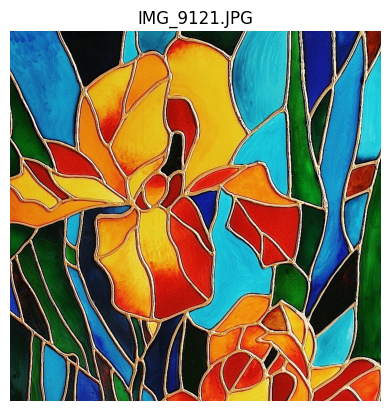

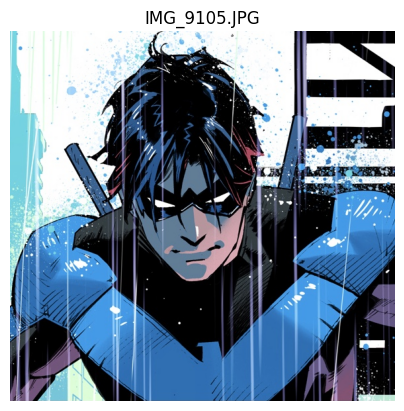

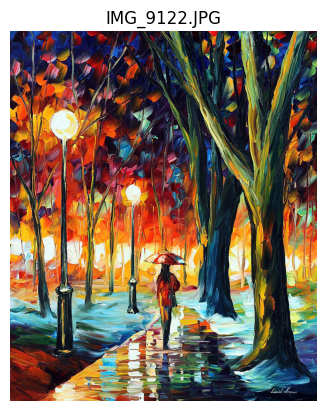

In [17]:
for file_name in style:
    img_path = os.path.join(style_images, file_name)
    img = Image.open(img_path)

    # Display the image
    plt.imshow(img)
    plt.title(file_name)
    plt.axis('off')
    plt.show()


### **Arbitrary Image Stylisation**

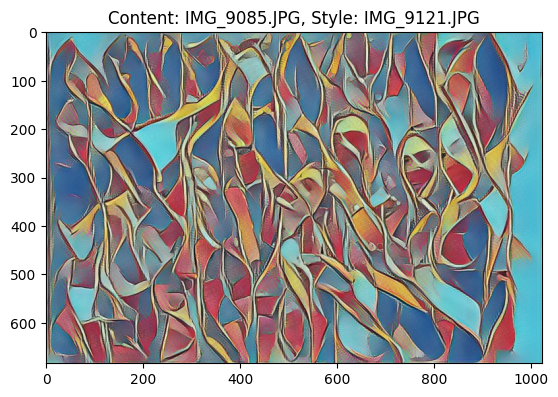

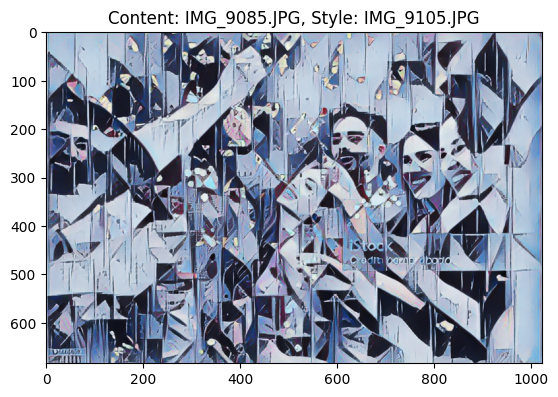

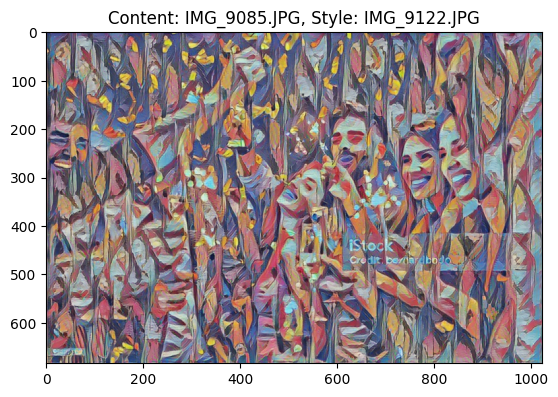

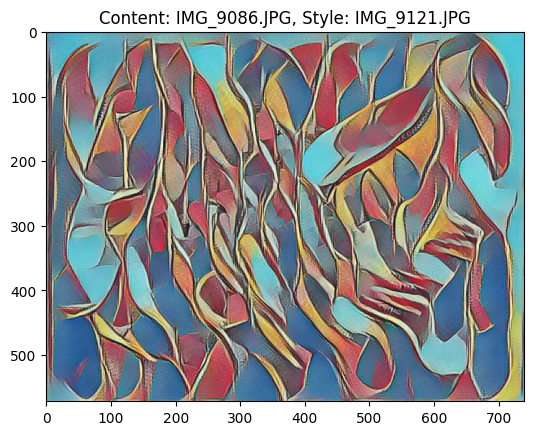

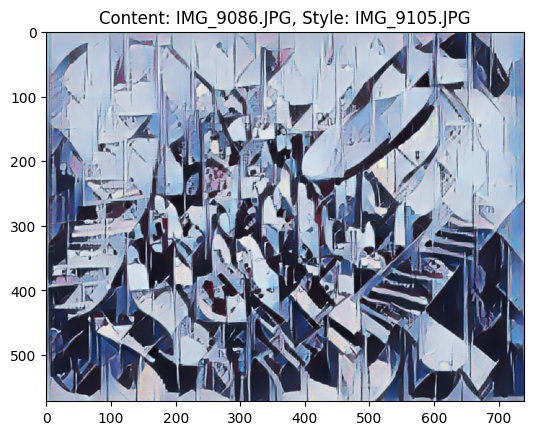

...

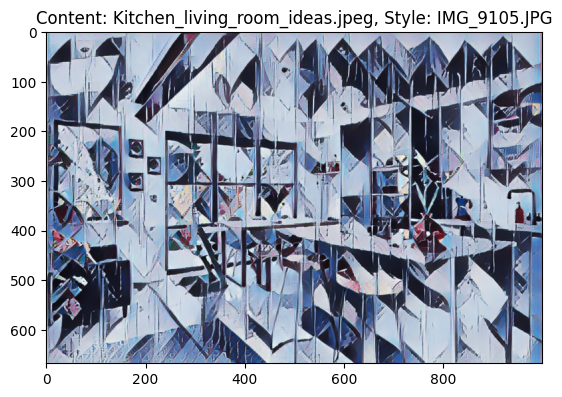

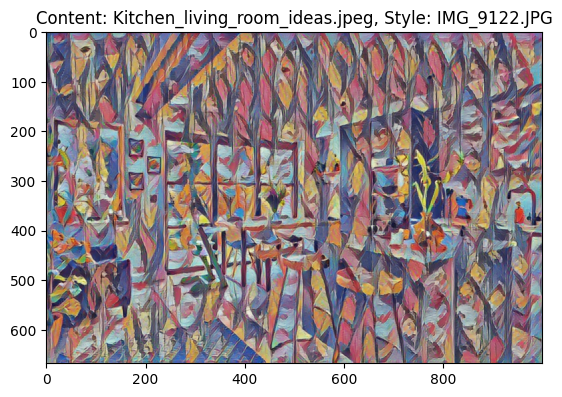

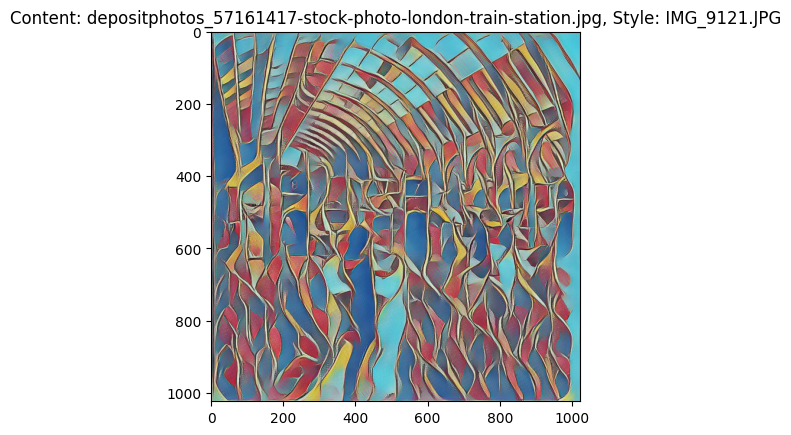

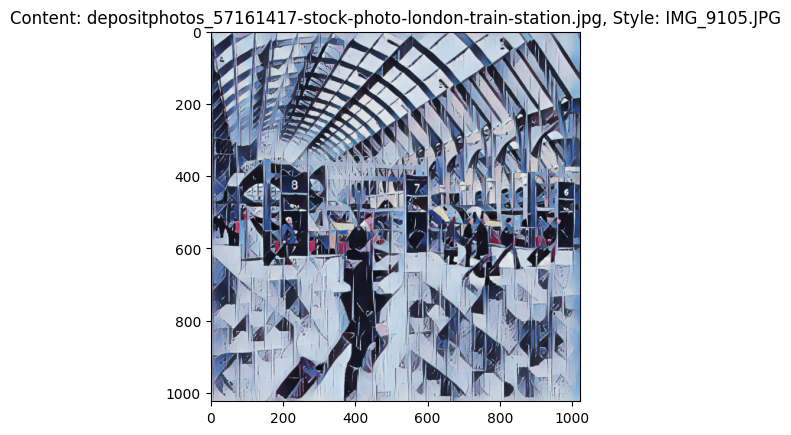

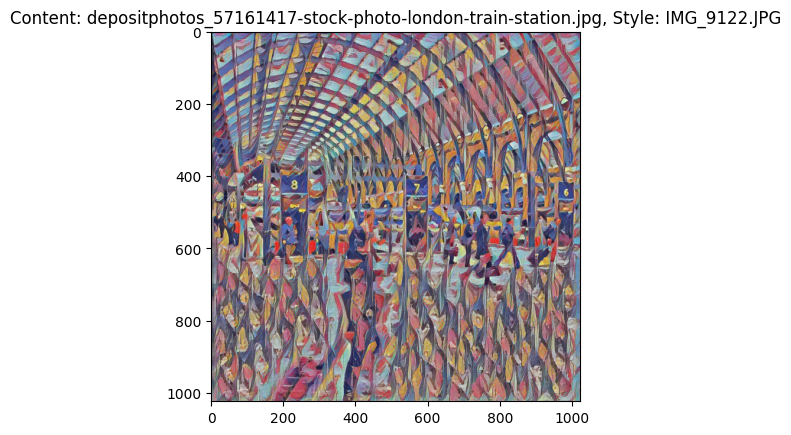

In [ ]:
import tensorflow_hub as hub
import tensorflow as tf
from matplotlib import pyplot as plt
import numpy as np
import cv2
import os

# Load the style transfer model
model = hub.load('https://tfhub.dev/google/magenta/arbitrary-image-stylization-v1-256/2')

# Define function to load an image
def load_image(img_path):
    img = tf.io.read_file(img_path)
    img = tf.image.decode_image(img, channels=3)
    img = tf.image.convert_image_dtype(img, tf.float32)
    img = img[tf.newaxis, :]
    return img

# Function to perform style transfer
def style_transfer(content_image, style_image):
    stylised_image = model(tf.constant(content_image), tf.constant(style_image))[0]
    return stylised_image

# Path to the directory containing content images
content_folder_path = "/content/drive/MyDrive/TIES4911_Demos/Demo 5/Test Images/"

# Path to the directory containing style images
style_folder_path = "/content/drive/MyDrive/TIES4911_Demos/Demo 5/Style Images/"

# Get a list of all content and style image files
content_image_files = [f for f in os.listdir(content_folder_path) if os.path.isfile(os.path.join(content_folder_path, f))]
style_image_files = [f for f in os.listdir(style_folder_path) if os.path.isfile(os.path.join(style_folder_path, f))]

# Process each combination of content and style images
for content_image_file in content_image_files:
    content_image_path = os.path.join(content_folder_path, content_image_file)
    content_image = load_image(content_image_path)

    for style_image_file in style_image_files:
        style_image_path = os.path.join(style_folder_path, style_image_file)
        style_image = load_image(style_image_path)

        # Perform style transfer
        stylised_image = style_transfer(content_image, style_image)

        # Display the stylised image
        plt.imshow(np.squeeze(stylised_image))
        plt.title(f"Content: {content_image_file}, Style: {style_image_file}")
        plt.show()